In [2]:
import cv2
import numpy as np
from skimage.io import imread
import matplotlib.pyplot as plt
import os
from skimage import measure
import pandas as pd
from scipy.ndimage import binary_opening
from skimage.morphology import square
from skimage import filters
from skimage import exposure

In [3]:
base_dir = r'C:\Users\ksevi\OneDrive\Desktop\MASTER\MIA Stephanie dedos\data'
folders = ['N1', 'N2', 'S2', 'S3']
images = []
for folder in folders:
    folder_path = os.path.join(base_dir, folder)
    for file in os.listdir(folder_path):
        if '_Natif' not in file:  # Skip files with "_Natif" in the name
            file_path = os.path.join(folder_path, file)
            images.append(file_path)

process_images(images)

NameError: name 'process_images' is not defined

In [4]:
def rotate_to_horizontal(image, line_angle):
    rotation_angle = 90+line_angle
    center = (image.shape[1] // 2, image.shape[0] // 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, rotation_angle, 1)
    rotated_image = cv2.warpAffine(image, rotation_matrix, (image.shape[1], image.shape[0]))
    return rotated_image, rotation_matrix 

In [5]:
def get_roi(image, line, image_path):
    x1, y1, x2, y2 = line[0]
    start = min(x1, x2)
    end = max(x1, x2)
    y_line = min(y1, y2)
    
    # Check if the image name starts with 'S2' or 'S3'
    if os.path.basename(image_path).startswith(('S2', 'S3')):
        height = 150
    else:
        height = 210

    if y_line < height:
        print("La línea está demasiado cerca del borde superior de la imagen para este tamaño de ROI.")
        height -= 10  # Restamos 10 al height si la línea está muy cerca del borde
        if y_line < height:  # Comprobamos nuevamente para asegurarnos de que aún tenemos suficiente espacio
            print("Incluso después de ajustar, la línea sigue estando demasiado cerca del borde.")
            return None
    roi = image[y_line-height:y_line, start-20:end+20]
    return roi

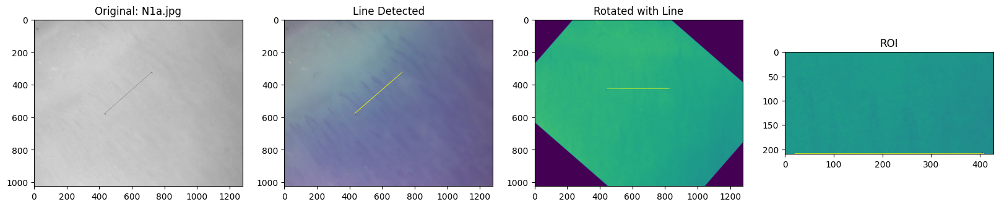

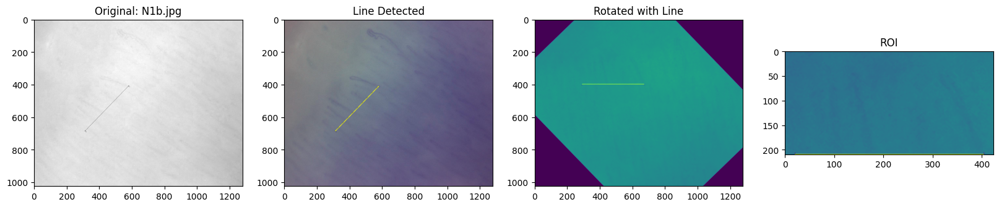

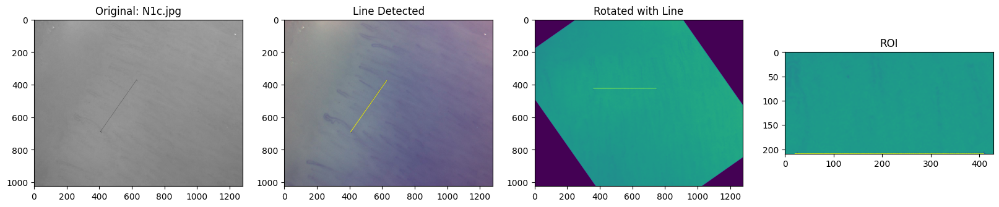

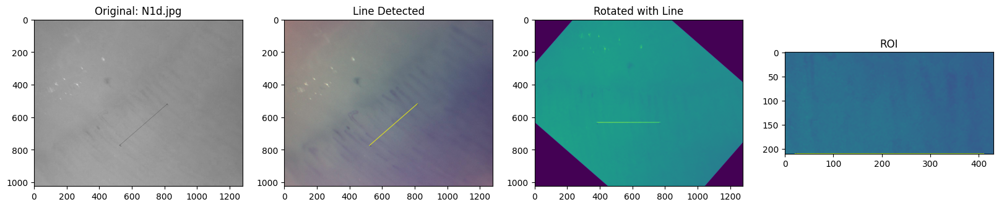

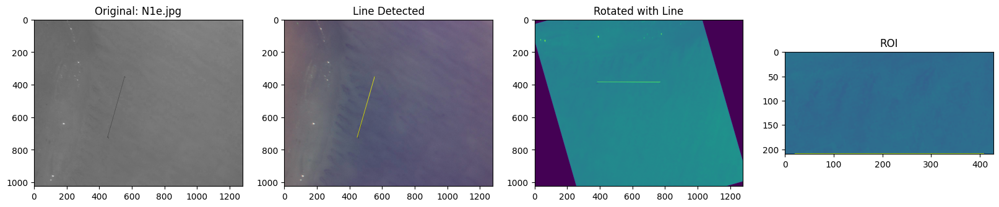

...

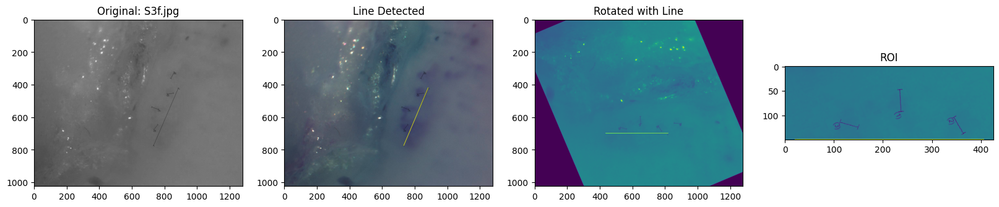

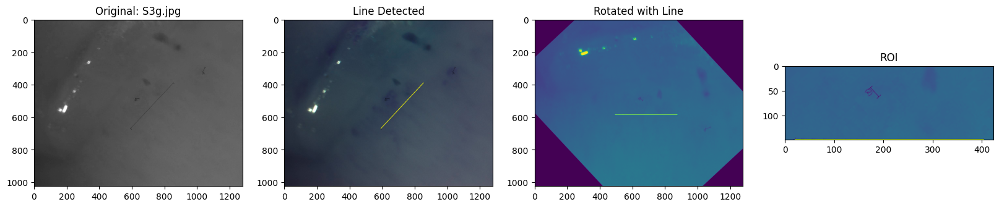

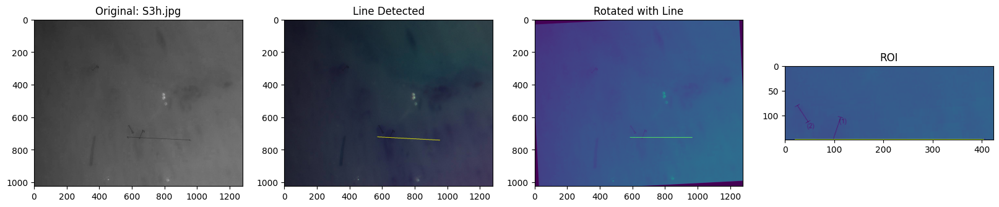

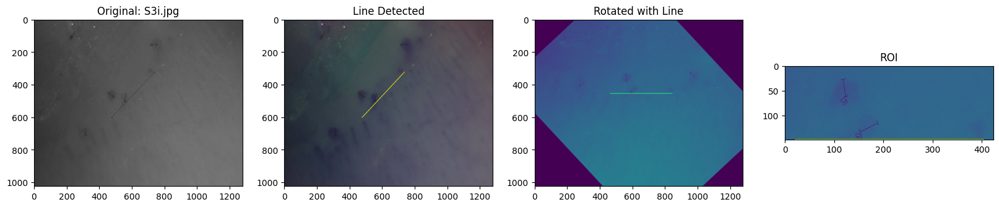

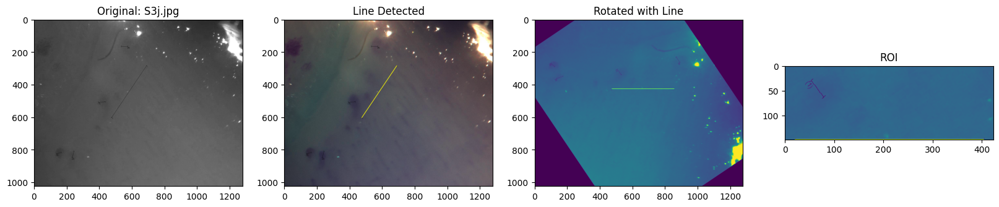

In [6]:
image_mapping = {}
transformation_info = {}
base_dir = r'C:\Users\ksevi\OneDrive\Desktop\MASTER\MIA Stephanie dedos\data'
folders = ['N1', 'N2', 'S2', 'S3']
images = []
rois_natif = []

for folder in folders:
    folder_path = os.path.join(base_dir, folder)
    for file in os.listdir(folder_path):
        file_path = os.path.join(folder_path, file)
        images.append(file_path)
        if '_Natif' in file_path:
            non_natif_path = file_path.replace('_Natif', '')
            image_mapping[non_natif_path] = file_path

for image_path in images:
    if '_Natif' in image_path:
        continue
    bgr_rayita = cv2.imread(image_path)
    rgb_rayita = cv2.cvtColor(bgr_rayita,cv2.COLOR_BGR2RGB)
    C3_rayita = bgr_rayita[:,:,2]
    
    canny_threshold1=30
    canny_threshold2=90 
    blur_kernel_size=(5, 5)
    hough_rho=1 
    hough_theta=np.pi / 180
    hough_threshold=100 
    hough_min_line_length=100 
    hough_max_line_gap=100

    blurred = cv2.GaussianBlur(C3_rayita, blur_kernel_size, 0)
    edges = cv2.Canny(blurred, canny_threshold1, canny_threshold2)
    lines = cv2.HoughLinesP(edges, hough_rho, hough_theta, hough_threshold, minLineLength=hough_min_line_length, maxLineGap=hough_max_line_gap)

    if lines is None:
        continue

    longest_line = max(lines, key=lambda line: np.sqrt((line[0][2]-line[0][0])**2 + (line[0][3]-line[0][1])**2))
    longest_line_img = np.copy(bgr_rayita).astype(np.uint8)
    cv2.line(longest_line_img, (longest_line[0][0], longest_line[0][1]), (longest_line[0][2], longest_line[0][3]), (255,255,0), 2)

    dx = longest_line[0][2] - longest_line[0][0] 
    dy = longest_line[0][3] - longest_line[0][1] 

    if dx != 0:  
        slope = dy / dx
    else:
        slope = np.inf

    angle = np.degrees(np.arctan(slope))

    if dx < 0:
        angle += 180

    angle -= 90

    rotated_image, rotation_matrix = rotate_to_horizontal(C3_rayita, angle)
    points = np.float32([[longest_line[0][0], longest_line[0][1]], [longest_line[0][2], longest_line[0][3]]]).reshape(-1, 1, 2)
    transformed_points = cv2.transform(points, rotation_matrix)
    transformed_line = transformed_points.reshape(-1, 4).astype(int)
    
    #filename = os.path.basename(image_path)
    #roi_height = 150 if filename.startswith('S') else 210
    #roi = get_roi(rotated_image, transformed_line, roi_height)
    
    roi = get_roi(rotated_image, transformed_line,image_path)

    if roi is not None:
        filename = os.path.basename(image_path)

        fig, ax = plt.subplots(1, 4, figsize=(20, 10))

        ax[0].imshow(C3_rayita, cmap='gray')
        ax[0].set_title(f"Original: {filename}")

        ax[1].imshow(longest_line_img)
        ax[1].set_title("Line Detected")

        cv2.line(rotated_image, (transformed_line[0][0], transformed_line[0][1]), (transformed_line[0][2], transformed_line[0][3]), (255,0,255), 2)
        ax[2].imshow(rotated_image)
        ax[2].set_title("Rotated with Line")

        ax[3].imshow(roi)
        ax[3].set_title("ROI")

        plt.show()

    transformation_info[image_path] = (angle, transformed_line)

In [7]:
for non_natif_path, natif_path in image_mapping.items():
    bgr_rayita_natif = cv2.imread(natif_path)  # This is the full color image

    angle, transformed_line = transformation_info[non_natif_path]
    rotated_image_natif, rotation_matrix_natif = rotate_to_horizontal(bgr_rayita_natif, angle)  # We are rotating the full color image
    roi_natif = get_roi(rotated_image_natif, transformed_line, natif_path)  # We get the ROI from the full color image

    if roi_natif is not None:
        roi_green_channel = roi_natif[:,:,1]  # We select only the green channel of the ROI
        rois_natif.append(roi_green_channel)

30


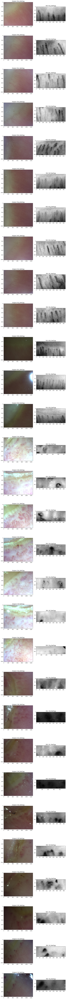

In [8]:
num_images = len(rois_natif)
print(len(rois_natif))

fig, axs = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))
for idx, (natif_path, roi) in enumerate(zip(image_mapping.values(), rois_natif)):
    image = cv2.imread(natif_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB

    axs[idx, 0].imshow(image)
    axs[idx, 0].set_title(f"Original: {os.path.basename(natif_path)}")

    axs[idx, 1].imshow(roi,cmap="gray")
    axs[idx, 1].set_title(f"ROI: {os.path.basename(natif_path)}")

plt.tight_layout()
plt.show()

In [9]:
def calculate_luminance(image):
    # Convert image to grayscale
    #gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)   
    # Calculate luminance
    luminance = image.mean()
    
    return luminance

#image_mapping is my dictionary of image paths
image_paths = list(image_mapping.values())

for idx, (roi, image_path) in enumerate(zip(rois_natif, image_paths)):
    luminance = calculate_luminance(roi)
    image_name = os.path.basename(image_path)
    print(f'Luminance for {image_name}: {luminance}')

Luminance for N1a_Natif.jpg: 140.32089452603472
Luminance for N1b_Natif.jpg: 124.45604222821204
Luminance for N1c_Natif.jpg: 129.33213453213455
Luminance for N1d_Natif.jpg: 122.28176997016904
Luminance for N1e_Natif.jpg: 92.77545616377392
Luminance for N1f_Natif.jpg: 106.24676034348165
Luminance for N1g_Natif.jpg: 106.24676034348165
Luminance for N1h_Natif.jpg: 117.47603471295061
Luminance for N1i_Natif.jpg: 96.94706743217381
Luminance for N1j_Natif.jpg: 102.92969778075164
Luminance for N2b_Natif.jpg: 65.20729411764705
Luminance for N2c_Natif.jpg: 79.30318207282913
Luminance for N2d_Natif.jpg: 74.4789131652661
Luminance for S2a_Natif.jpg: 199.92108380592313
Luminance for S2b_Natif.jpg: 215.3745882352941
Luminance for S2c_Natif.jpg: 216.00922118380063
Luminance for S2d_Natif.jpg: 154.7188473520249
Luminance for S2e_Natif.jpg: 202.81131782945735
Luminance for S2f_Natif.jpg: 208.72426791277258
Luminance for S2g_Natif.jpg: 190.15661467359908
Luminance for S3a_Natif.jpg: 93.61689814814815
L

In [11]:
def process_images(images, image_paths):
    results = {}

    for idx, (img, image_path) in enumerate(zip(images, image_paths)):
        low =60
        high = 90
        
        luminance = calculate_luminance(img)
        print(f'Luminance for {os.path.basename(image_path)}: {luminance}')

        if luminance < 88:
            equ = cv2.equalizeHist(img)
            clahe = cv2.createCLAHE(clipLimit=5, tileGridSize=(6,6))
            clahe_roi = clahe.apply(equ)
            thresh_image = cv2.adaptiveThreshold(equ,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV,125,20)
        else:
            equ = cv2.equalizeHist(img)
            clahe = cv2.createCLAHE(clipLimit=20.0, tileGridSize=(6,6))
            clahe_roi = clahe.apply(img)
            thresh_image = cv2.adaptiveThreshold(clahe_roi,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV,125,50)

        dilated1 = binary_opening(thresh_image, square(4))
        dilated1 = dilated1.astype(np.uint8) * 255

        kernel4 = np.ones((3,3),np.uint8)
        dilation2 = cv2.dilate(dilated1,kernel4 ,iterations = 1)

        kernel7 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(7,7))
        opening1 = binary_opening(dilation2  ,kernel7)
        opening1 = opening1.astype(np.uint8) * 255

        hyst = filters.apply_hysteresis_threshold(~ opening1, low, high)
        opening1 = hyst.astype(np.uint8) * 255
        engorde = cv2.dilate(opening1, kernel7 ,iterations = 1)

        kernel3 = np.ones((5,5),np.uint8)
        erosion = cv2.erode(engorde , kernel3, iterations = 1)

        closed = cv2.morphologyEx(erosion, cv2.MORPH_CLOSE, kernel3)

        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
        opened = cv2.morphologyEx(closed, cv2.MORPH_OPEN, kernel)

        kernel_ = np.ones((3,3),np.uint8)
        dilated = cv2.dilate(opened, kernel_, iterations = 2)
      
        num_labels, labels = cv2.connectedComponents(dilation2)
        print(num_labels)
        contour_img = cv2.cvtColor(dilated.copy(), cv2.COLOR_GRAY2BGR)

        capillary_count = 0
        
        def slope_and_distance(contour1, contour2):
            M1 = cv2.moments(contour1)
            M2 = cv2.moments(contour2)

            cX1 = int(M1["m10"] / M1["m00"])
            cY1 = int(M1["m01"] / M1["m00"])

            cX2 = int(M2["m10"] / M2["m00"])
            cY2 = int(M2["m01"] / M2["m00"])

            slope = (cY2 - cY1) / (cX2 - cX1)
            distance = np.sqrt((cX2 - cX1)**2 + (cY2 - cY1)**2)

            return slope, distance
        
        def is_horizontal(contour):
            if len(contour) < 5:  # A contour must have at least 5 points to fit an ellipse
                return False
            _, _, angle = cv2.fitEllipse(contour)
            return abs(angle - 90) < 15  # Consider a contour as horizontal if its angle is close to 90 degrees

        def is_tubular(contour):
            area = cv2.contourArea(contour)
            length = cv2.arcLength(contour, True)
            return area / length > 0.5
        distance_threshold = 20.0

        for label in range(1, num_labels):
            component = np.zeros_like(opened)
            component[labels == label] = 255

            contours, _ = cv2.findContours(component, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

            min_contour_area = 260
            contours = [cnt for cnt in contours if cv2.contourArea(cnt) > min_contour_area and not is_horizontal(cnt)]

            if capillary_count >= 10:
                contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]

            merged_contours = []
            for i in range(len(contours)):
                for j in range(i+1, len(contours)):
                    slope, distance = slope_and_distance(contours[i], contours[j])
                    if abs(slope) > 0.5 and abs(slope) < 1.5 and distance < distance_threshold:
                        merged_contours.append(contours[i])  # or some operation to merge contours
                        break
                else:
                    merged_contours.append(contours[i])

            for contour in merged_contours:
                if is_tubular(contour):
                    capillary_count += 1
                    cv2.drawContours(contour_img, [contour], -1, (0, 255, 0), 2)
                if capillary_count >= 10:
                    break  # Stop counting once we have found 10 capillaries

            if capillary_count >= 10:
                break  # Stop processing labels once we have found 10 capillaries

        image_name = os.path.basename(image_path)
        results[image_name] = capillary_count

        # Plotting
        fig, ax = plt.subplots(1, 2, figsize=(20, 10))

        ax[0].imshow(img)
        ax[0].set_title(f'Original Image - {image_name}')

        ax[1].imshow(cv2.cvtColor(contour_img, cv2.COLOR_BGR2RGB))
        ax[1].set_title(f'Contours - Number of capillaries: {capillary_count}')
        
        #ax[2].hist(img.ravel(), bins=256, color='gray')
        #ax[2].set_title(f'Histogram - {image_name}')

        plt.tight_layout()
        plt.show()

    return results

Luminance for N1a_Natif.jpg: 140.32089452603472
17


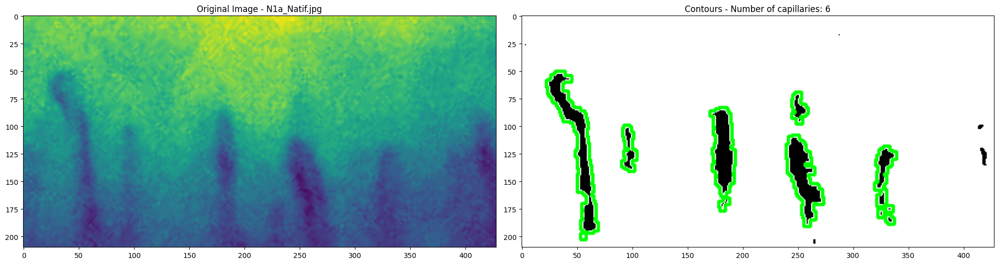

Luminance for N1b_Natif.jpg: 124.45604222821204
19


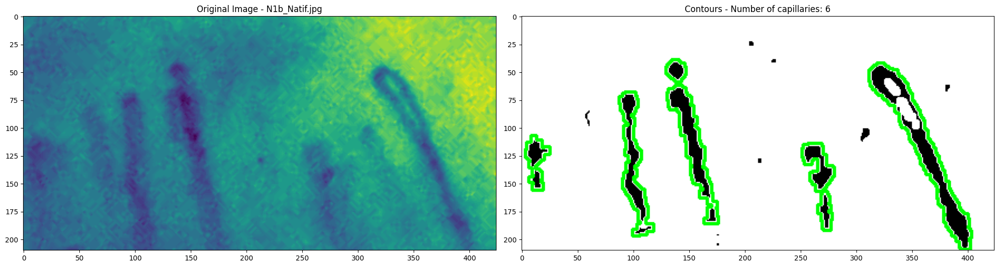

Luminance for N1c_Natif.jpg: 129.33213453213455
32


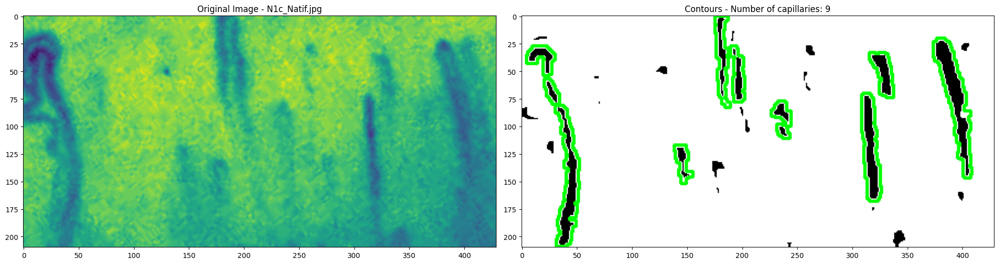

Luminance for N1d_Natif.jpg: 122.28176997016904
42


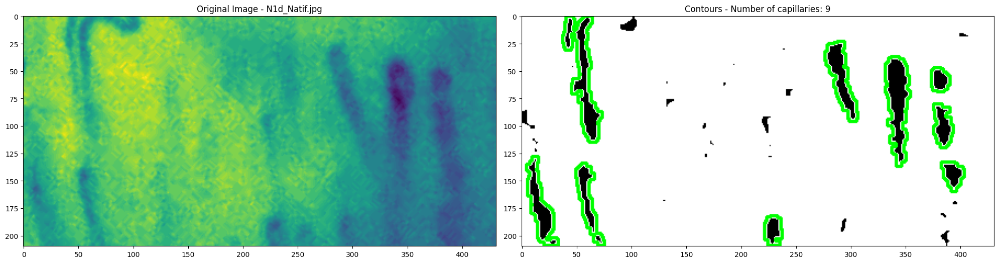

Luminance for N1e_Natif.jpg: 92.77545616377392
33


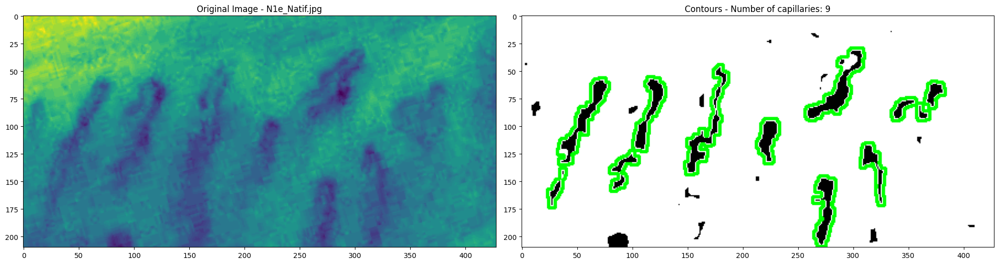

Luminance for N1f_Natif.jpg: 106.24676034348165
28


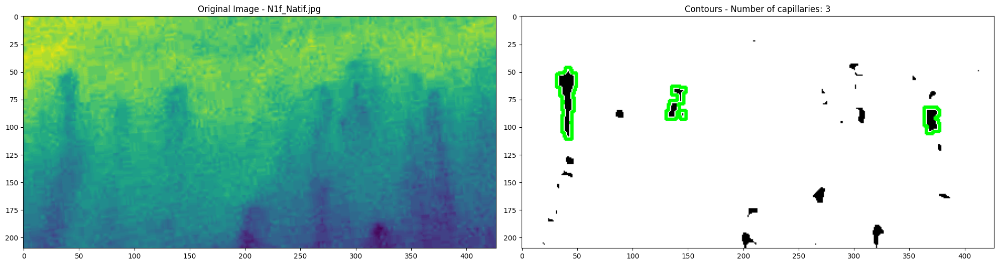

Luminance for N1g_Natif.jpg: 106.24676034348165
28


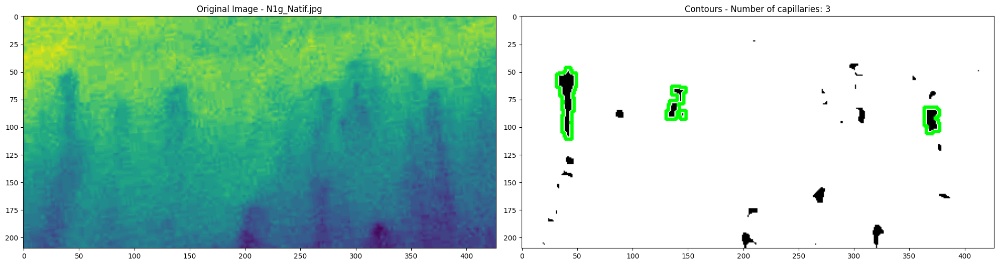

Luminance for N1h_Natif.jpg: 117.47603471295061
33


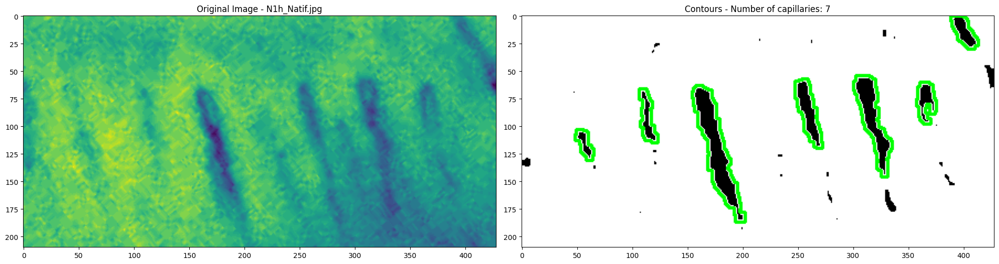

Luminance for N1i_Natif.jpg: 96.94706743217381
22


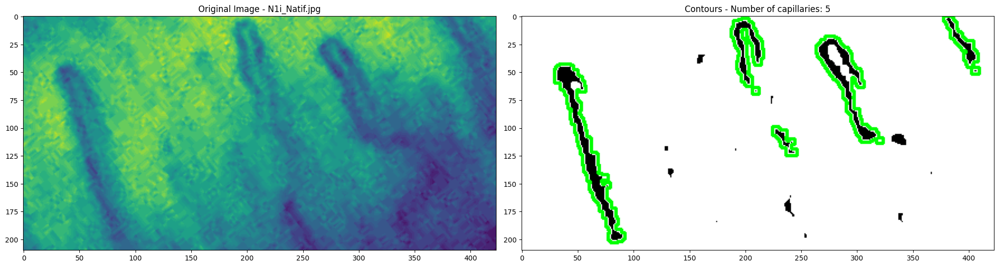

Luminance for N1j_Natif.jpg: 102.92969778075164
27


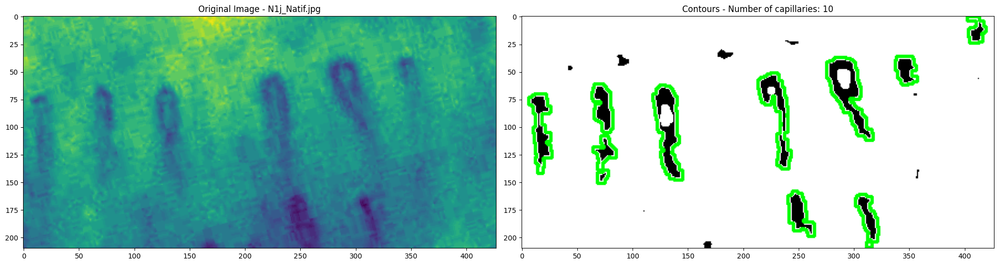

Luminance for N2b_Natif.jpg: 65.20729411764705
63


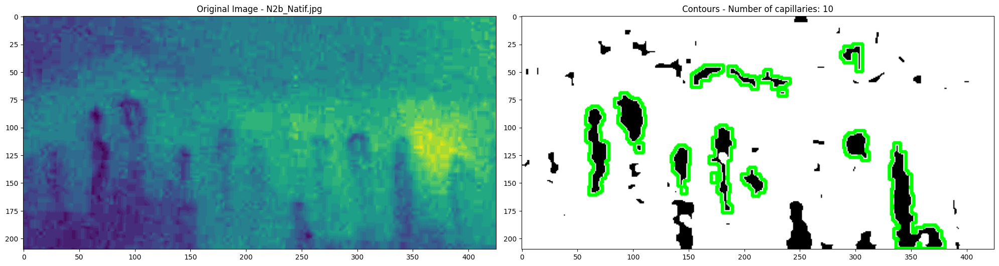

Luminance for N2c_Natif.jpg: 79.30318207282913
33


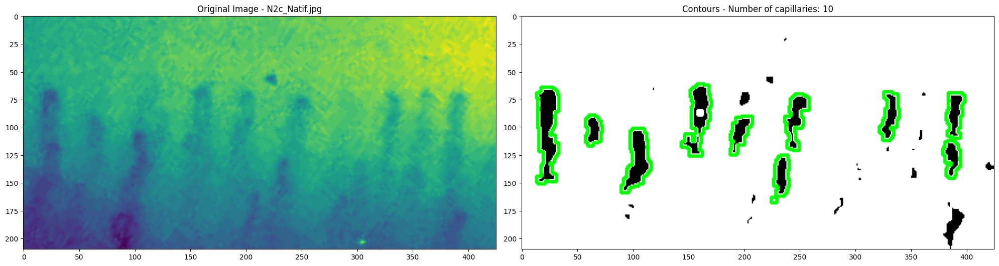

Luminance for N2d_Natif.jpg: 74.4789131652661
38


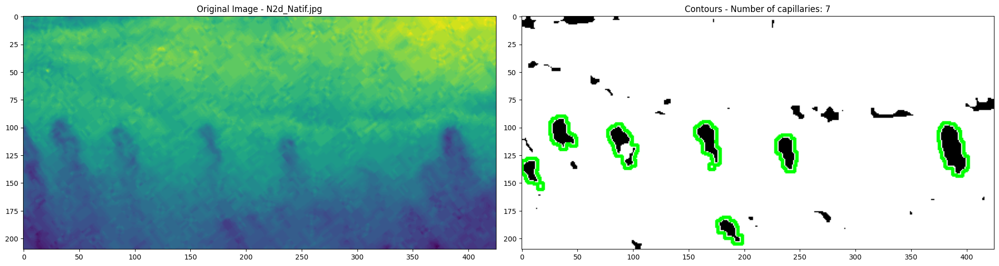

Luminance for S2a_Natif.jpg: 199.92108380592313
41


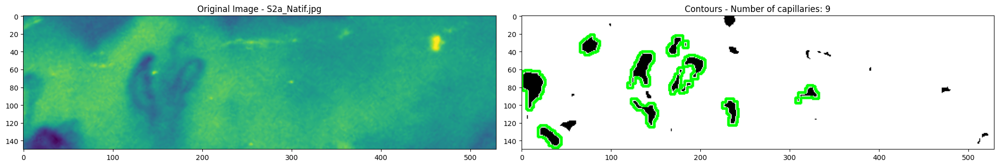

Luminance for S2b_Natif.jpg: 215.3745882352941
28


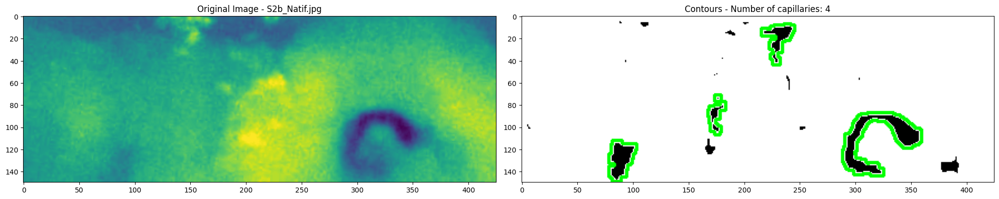

Luminance for S2c_Natif.jpg: 216.00922118380063
28


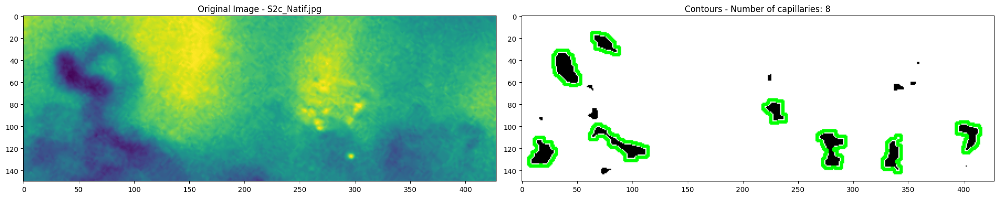

Luminance for S2d_Natif.jpg: 154.7188473520249
36


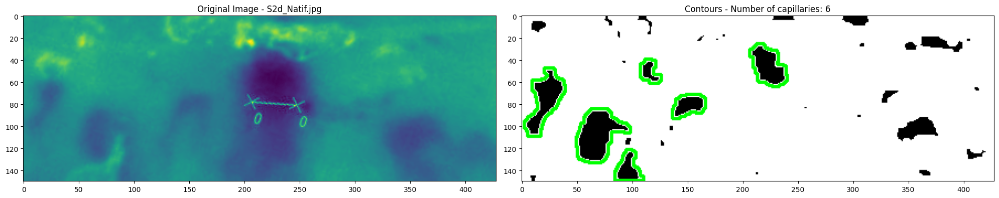

Luminance for S2e_Natif.jpg: 202.81131782945735
22


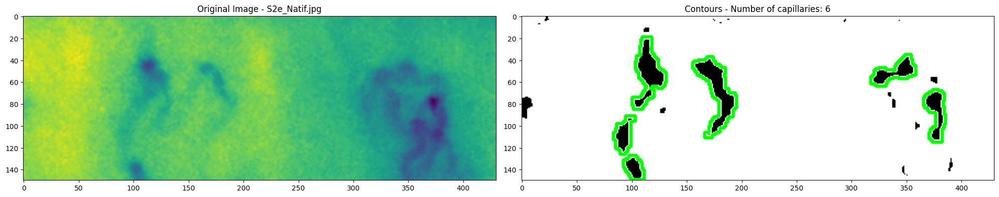

Luminance for S2f_Natif.jpg: 208.72426791277258
28


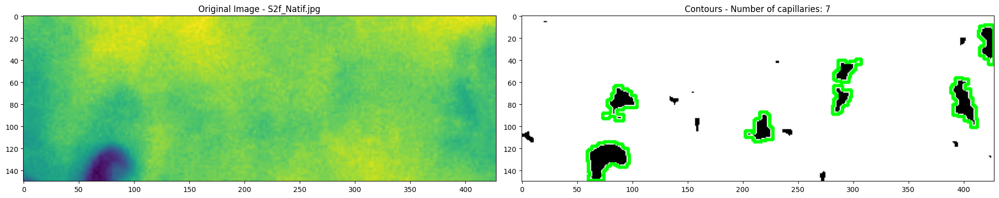

Luminance for S2g_Natif.jpg: 190.15661467359908
27


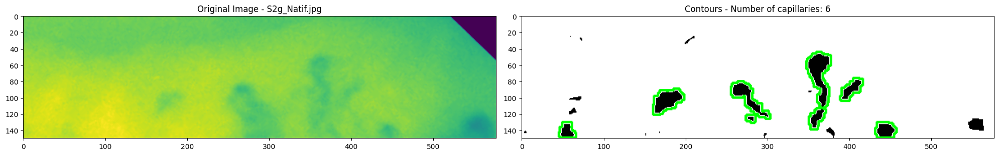

Luminance for S3a_Natif.jpg: 93.61689814814815
8


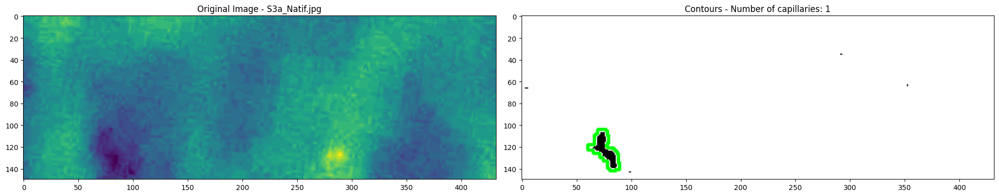

Luminance for S3b_Natif.jpg: 87.8912724434036
16


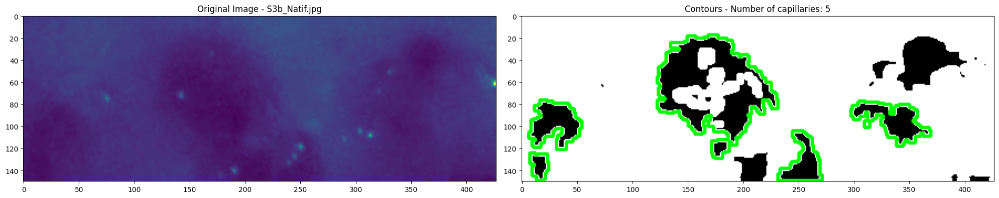

Luminance for S3c_Natif.jpg: 77.30483137254902
49


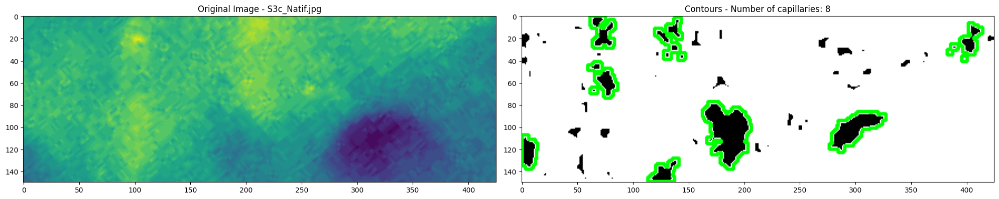

Luminance for S3d_Natif.jpg: 84.11505030181087
19


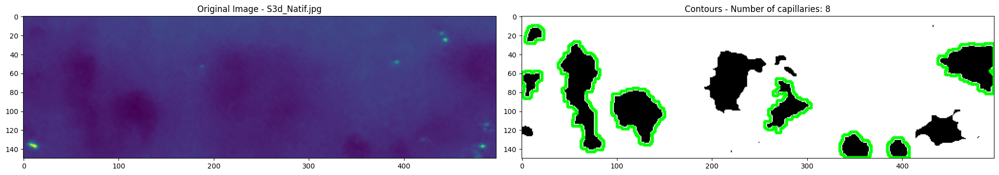

Luminance for S3e_Natif.jpg: 69.29553459119496
20


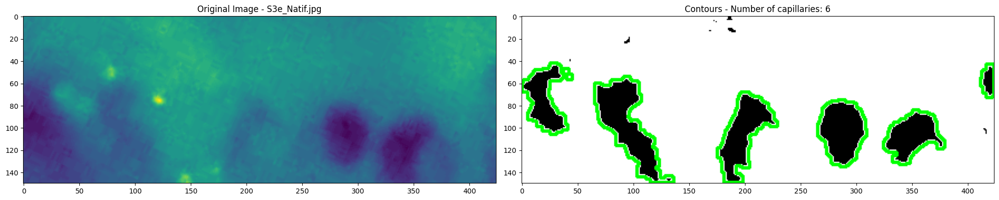

Luminance for S3f_Natif.jpg: 83.97131455399061
15


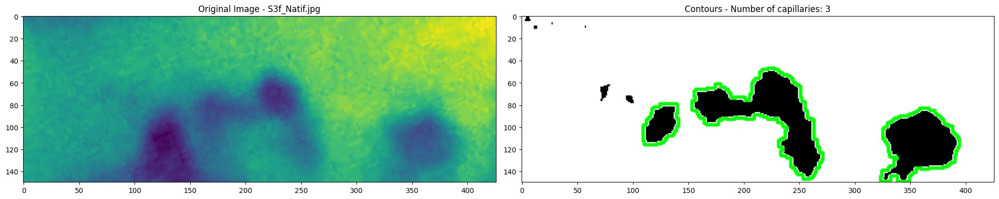

Luminance for S3g_Natif.jpg: 64.50977987421383
14


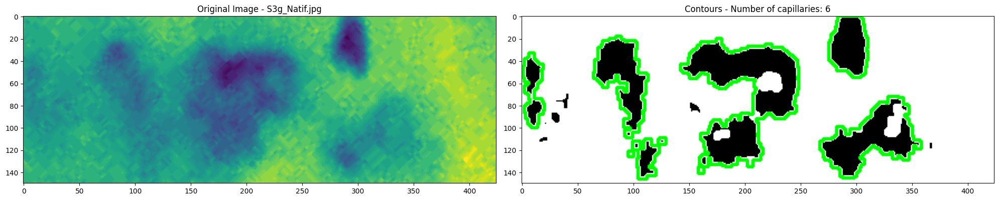

Luminance for S3h_Natif.jpg: 50.61941823899371
40


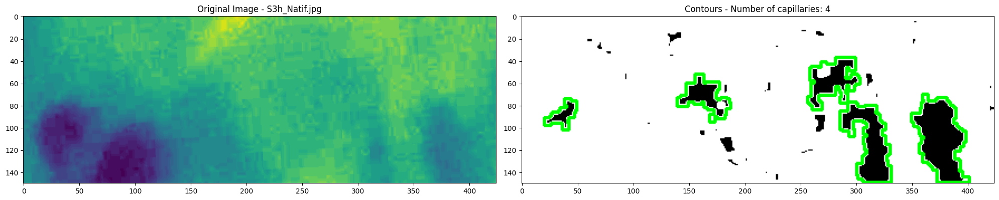

Luminance for S3i_Natif.jpg: 73.8383962264151
20


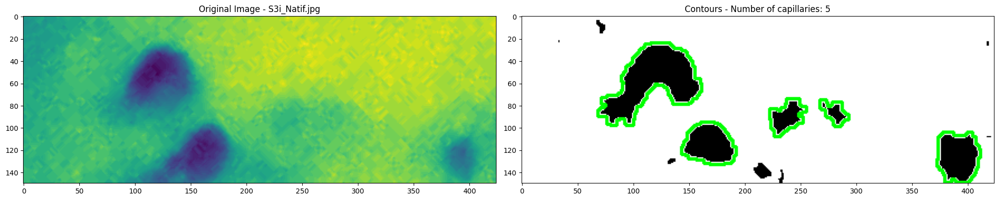

Luminance for S3j_Natif.jpg: 76.04064465408806
27


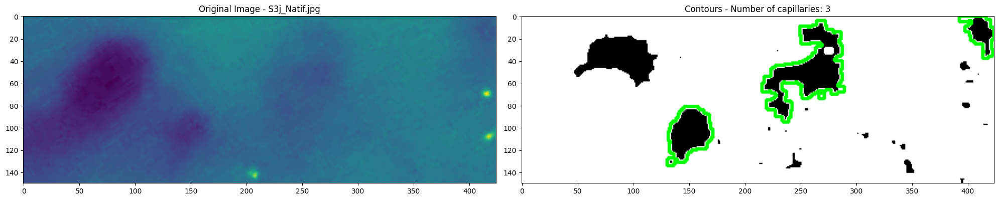

In [12]:
image_paths = list(image_mapping.values())  #image_mapping is my dictionary of image paths
results = process_images(rois_natif, image_paths)

In [13]:
for image_name, capillary_count in results.items():
    print(f'{image_name}: {capillary_count} capillaries')

N1a_Natif.jpg: 6 capillaries
N1b_Natif.jpg: 6 capillaries
N1c_Natif.jpg: 9 capillaries
N1d_Natif.jpg: 9 capillaries
N1e_Natif.jpg: 9 capillaries
N1f_Natif.jpg: 3 capillaries
N1g_Natif.jpg: 3 capillaries
N1h_Natif.jpg: 7 capillaries
N1i_Natif.jpg: 5 capillaries
N1j_Natif.jpg: 10 capillaries
N2b_Natif.jpg: 10 capillaries
N2c_Natif.jpg: 10 capillaries
N2d_Natif.jpg: 7 capillaries
S2a_Natif.jpg: 9 capillaries
S2b_Natif.jpg: 4 capillaries
S2c_Natif.jpg: 8 capillaries
S2d_Natif.jpg: 6 capillaries
S2e_Natif.jpg: 6 capillaries
S2f_Natif.jpg: 7 capillaries
S2g_Natif.jpg: 6 capillaries
S3a_Natif.jpg: 1 capillaries
S3b_Natif.jpg: 5 capillaries
S3c_Natif.jpg: 8 capillaries
S3d_Natif.jpg: 8 capillaries
S3e_Natif.jpg: 6 capillaries
S3f_Natif.jpg: 3 capillaries
S3g_Natif.jpg: 6 capillaries
S3h_Natif.jpg: 4 capillaries
S3i_Natif.jpg: 5 capillaries
S3j_Natif.jpg: 3 capillaries


In [20]:
ground_truth = {
    'N1a': 6, 'N1b': 7, 'N1c': 9, 'N1d': 8, 'N1e': 8, 'N1f': 9, 'N1g': 9, 'N1h': 7, 'N1i': 7, 'N1j': 8,
    'N2b': 10, 'N2c': 9, 'N2d': 7, 'S2a': 1, 'S2b': 2, 'S2c': 2, 'S2d': 5, 'S2e': 4, 'S2f': 1, 'S2g': 4,
    'S3a': 5, 'S3b': 5, 'S3c': 2, 'S3d': 5, 'S3e': 5, 'S3f': 4, 'S3g': 5, 'S3h': 4, 'S3i': 2, 'S3j': 5
}

predicted_values = {
    'N1a': 7, 'N1b': 6, 'N1c': 11, 'N1d': 13, 'N1e': 10, 'N1f': 7, 'N1g': 7, 'N1h': 13, 'N1i': 6, 'N1j': 11,
    'N2b': 7, 'N2c': 10, 'N2d': 7, 'S2a': 8, 'S2b': 8, 'S2c': 9, 'S2d': 21, 'S2e': 9, 'S2f': 7, 'S2g': 10,
    'S3a': 6, 'S3b': 5, 'S3c': 2, 'S3d': 11, 'S3e': 5, 'S3f': 7, 'S3g': 9, 'S3h': 8, 'S3i': 5, 'S3j': 3
}

correct_predictions = sum(ground_truth[key] == predicted_values[key] for key in ground_truth)
accuracy = correct_predictions / len(ground_truth)

print(f'"Accuracy": {accuracy * 100}%')

#As I mentioned in my presentation this is just an indicator even though it is not a machine learning problem"
#and it is not correct to find it, I wanted to know how much my data differed from the labeling you gave us"

"Accuracy": 13.333333333333334%


In [19]:
ground_truth_values = np.array(list(ground_truth.values()))
predicted_values = np.array(list(predicted_values.values()))

differences = ground_truth_values - predicted_values
standard_deviation = np.std(differences)

print(f'Standard deviation: {standard_deviation}')

Standard deviation: 3.8616346567512343
